In [1]:
# import modin.config as cfg
# cfg.StorageFormat.put('hdk')
# import modin.pandas as pd

import pandas as pd

In [2]:
from sklearnex import patch_sklearn
patch_sklearn()

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


In [3]:
import os
import daal4py as d4p
import time
import warnings
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import missingno as msno
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder

from sklearn.experimental import enable_iterative_imputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import BayesianRidge, LinearRegression, LogisticRegression

intel_pal, color=['#0071C5','#FCBB13'], ['#7AB5E1','#FCE7B2']
temp=dict(layout=go.Layout(font=dict(family="Franklin Gothic", size=12), height=500, width=1000))

read csv took: 2.84 s

There are 237,180 missing values in the data.
There are 1,088 duplicate records in the data.


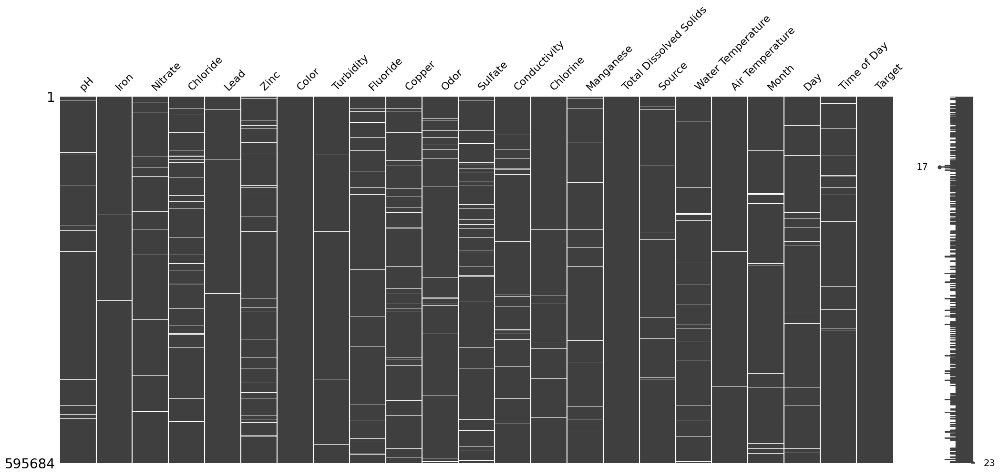

In [4]:
start_read = time.time()
data = pd.read_csv("500k_dataset.csv")
# data = pd.read_csv("dataset.csv")
print("read csv took: {:.2f} s".format(time.time() - start_read))

data.drop(['Index'], inplace=True, axis=1)

# display missing columns
msno.matrix(data)

missing = data.isna().sum().sum()
duplicates = data.duplicated().sum()
print("\nThere are {:,.0f} missing values in the data.".format(missing))
print("There are {:,.0f} duplicate records in the data.".format(duplicates))

handle missing value took: 0.49 s


<AxesSubplot:>

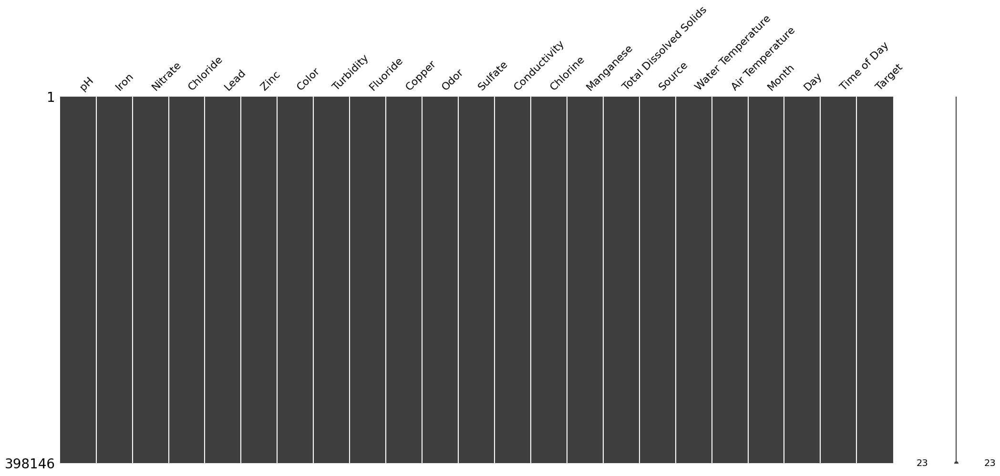

In [5]:
# handle missing values
start = time.time()

# cat_imputer = SimpleImputer(strategy='most_frequent')
# # num_imputer = IterativeImputer(estimator=RandomForestRegressor(n_estimators=5, random_state=0, n_jobs=-1), max_iter=5)
# num_imputer = KNNImputer(n_neighbors=2)

# cat_cols = data.select_dtypes(include=['object']).columns
# num_cols = data.select_dtypes(exclude=['object']).columns

# data[cat_cols] = cat_imputer.fit_transform(data[cat_cols])
# # data[num_cols] = num_imputer.fit_transform(data[num_cols])
# for col in num_cols:
#     data[col] = data[col].interpolate(method='linear')

data.dropna(subset=data.columns, inplace=True)

print("handle missing value took: {:.2f} s".format(time.time() - start))

# display missing columns
msno.matrix(data)

In [6]:
# transform `Month` to number
month_dict = {
    'January': 1,
    'February': 2,
    'March': 3,
    'April': 4,
    'May': 5,
    'June': 6,
    'July': 7,
    'August': 8,
    'September': 9,
    'October': 10,
    'November': 11,
    'December': 12
}
data['Month'] = data['Month'].map(month_dict)

color_dict = {
    'Colorless': 0,
    'Near Colorless': 1,
    'Faint Yellow': 2,
    'Light Yellow': 3,
    'Yellow': 4
}
data['Color'] = data['Color'].map(color_dict)

# convert air temperature from °F to°C
data['Air Temperature'] = (data['Air Temperature'] - 32) * 5/9

In [7]:
# drop duplicated rows
data = data.drop_duplicates()

# check data
missing = data.isna().sum().sum()
duplicates = data.duplicated().sum()
print("\nThere are {:,.0f} missing values in the data.".format(missing))
print("There are {:,.0f} duplicate records in the data.".format(duplicates))

display(data.head())


There are 0 missing values in the data.
There are 0 duplicate records in the data.


,pH,Iron,Nitrate,Chloride,Lead,Zinc,Color,Turbidity,Fluoride,Copper,...,Chlorine,Manganese,Total Dissolved Solids,Source,Water Temperature,Air Temperature,Month,Day,Time of Day,Target
1,8.574330,3.600729e-03,11.236134,150.015099,3.992670e-61,3.590989,3,1.051458,1.422666,0.773502,...,4.001868,1.540051e+00,86.764591,Well,10.951192,19.934591,10,3.0,8.0,1
2,6.754215,2.242093e-01,9.838300,126.665161,8.205945e-08,1.265744,1,0.001308,0.718139,0.037652,...,3.743012,3.190700e-07,396.609596,River,24.962711,17.773159,12,1.0,13.0,0
4,7.316263,9.183142e-07,9.636736,212.130670,7.907960e-56,0.800412,2,0.733317,0.179237,1.005681,...,2.222523,8.823558e-07,293.961541,Reservoir,13.007966,15.291942,2,27.0,14.0,0
6,6.627837,1.543835e-09,8.434956,261.295353,1.305907e-54,9.130563,4,0.423508,1.107844,2.402732,...,3.740620,7.206398e-10,441.077639,Aquifer,21.141749,11.376926,5,17.0,23.0,1
7,7.947503,2.854393e-02,5.696433,170.494665,1.524223e-51,3.304141,0,0.739038,1.333705,0.335039,...,2.644587,1.945463e-05,19.009614,Aquifer,15.969429,28.210876,12,14.0,1.0,0


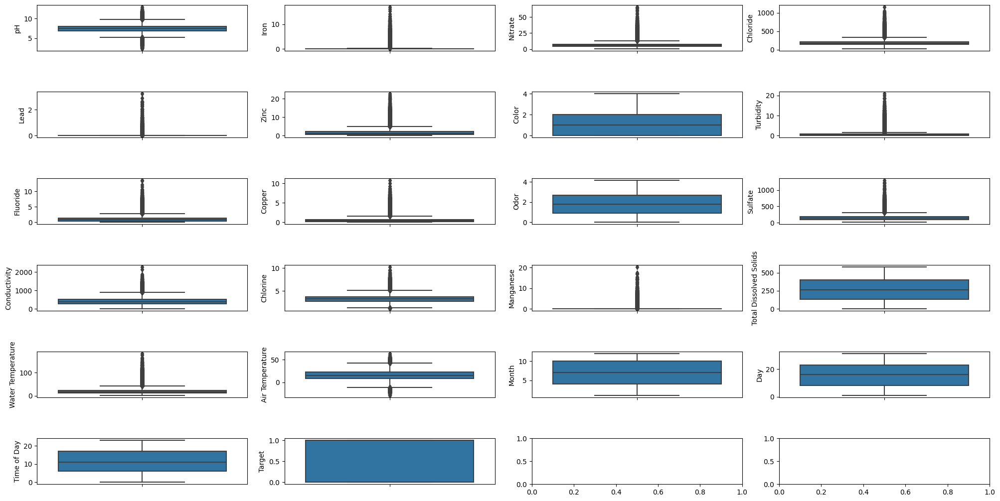

In [8]:
# Visualizing dataset and also checking for outliers 

fig, ax = plt.subplots(ncols = 4, nrows = 6, figsize = (20, 10))
index = 0
ax = ax.flatten()

for col, value in data.items():
    if data[col].dtype == 'object':
        continue
    sns.boxplot(y=col, data=data, ax=ax[index])
    index += 1
plt.tight_layout(pad = 0.5, w_pad=0.7, h_pad=5.0)

In [9]:
def display_stats():
    
    """
    Function to display descriptive statistics of numerical variables,
    includes skewness & kurtosis.   
    """
    
    df = data.describe().transpose()
    skewness = pd.DataFrame(data.skew(numeric_only=True), columns=['skewness'])
    kurtosis = pd.DataFrame(data.kurt(numeric_only=True), columns=['kurtosis'])
    df = pd.concat([df, skewness, kurtosis], axis=1)
    display(df.style.format('{:,.3f}').background_gradient(subset=(df.index[1:],df.columns[:]), cmap='GnBu'))

display_stats()

,count,mean,std,min,25%,50%,75%,max,skewness,kurtosis
pH,"397,066.000",7.447,0.889,2.326,6.896,7.451,8.015,12.897,-0.091,1.436
Iron,"397,066.000",0.128,0.480,0.000,0.000,0.002,0.055,17.066,8.652,113.164
Nitrate,"397,066.000",6.173,3.267,0.489,3.973,5.604,7.668,65.710,2.286,12.124
Chloride,"397,066.000",184.498,68.622,23.639,138.183,176.151,218.079,"1,157.697",1.622,6.265
Lead,"397,066.000",0.002,0.033,0.000,0.000,0.000,0.000,3.225,40.053,"2,189.654"
Zinc,"397,066.000",1.546,1.542,0.000,0.415,1.081,2.224,22.775,2.052,7.646
Color,"397,066.000",1.407,1.280,0.000,0.000,1.000,2.000,4.000,0.606,-0.723
Turbidity,"397,066.000",0.523,0.930,0.000,0.039,0.209,0.626,20.942,4.545,31.874
Fluoride,"397,066.000",0.961,0.819,0.000,0.373,0.773,1.338,13.539,2.110,8.332
Copper,"397,066.000",0.515,0.595,0.000,0.129,0.348,0.699,10.755,3.087,15.561


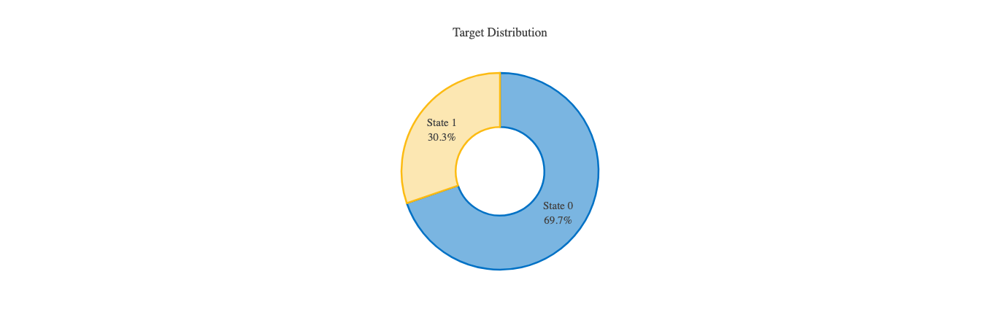

In [10]:
# show target distribution
target=data['Target'].value_counts(normalize=True)
target.rename(index={1:'State 1',0:'State 0'},inplace=True)
fig=go.Figure()
fig.add_trace(go.Pie(labels=target.index, values=target*100, hole=.45, 
                     text=target.index, sort=False, showlegend=False,
                     marker=dict(colors=color,line=dict(color=intel_pal,width=2.5)),
                     hovertemplate = "%{label}: <b>%{value:.2f}%</b><extra></extra>"))
fig.update_layout(template=temp, title='Target Distribution',width=700,height=450,
                  uniformtext_minsize=15, uniformtext_mode='hide')
fig.show() 

In [11]:
cat_cols,float_cols=[],['Target']
for col in data.columns:
    if data[col].value_counts().count() < 100:
        cat_cols.append(col)
    else:
        float_cols.append(col)
        
print(cat_cols)
print(float_cols)

['Color', 'Source', 'Month', 'Day', 'Time of Day', 'Target']
['Target', 'pH', 'Iron', 'Nitrate', 'Chloride', 'Lead', 'Zinc', 'Turbidity', 'Fluoride', 'Copper', 'Odor', 'Sulfate', 'Conductivity', 'Chlorine', 'Manganese', 'Total Dissolved Solids', 'Water Temperature', 'Air Temperature']


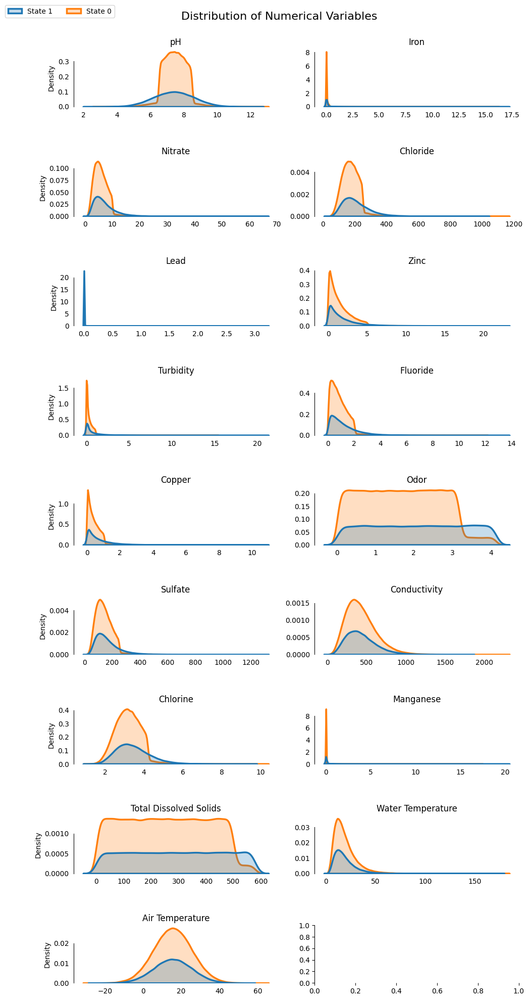

In [12]:
plot_df=data[float_cols]

fig, ax = plt.subplots(9,2, figsize=(10,20))
fig.suptitle('Distribution of Numerical Variables',fontsize=16)
row=0
col=[0,1]*9

for i, column in enumerate(plot_df.columns[1:]):
    if (i!=0)&(i%2==0):
        row+=1
    
    sns.kdeplot(
        x=column, hue='Target', hue_order=[1, 0],
        label=['State 1', 'State 0'], data=plot_df,
        fill=True, linewidth=2.5, legend=False, ax=ax[row, col[i]]
    )
    
    ax[row,col[i]].tick_params(left=False, bottom=False)
    ax[row,col[i]].set(title='\n\n{}'.format(column), xlabel='', ylabel=('Density' if i%2==0 else ''))

handles, _ = ax[0,0].get_legend_handles_labels() 
fig.legend(labels=['State 1','State 0'], handles=reversed(handles), ncol=3, bbox_to_anchor=(0.18, 0.99))
sns.despine(bottom=True, trim=True)
plt.tight_layout()

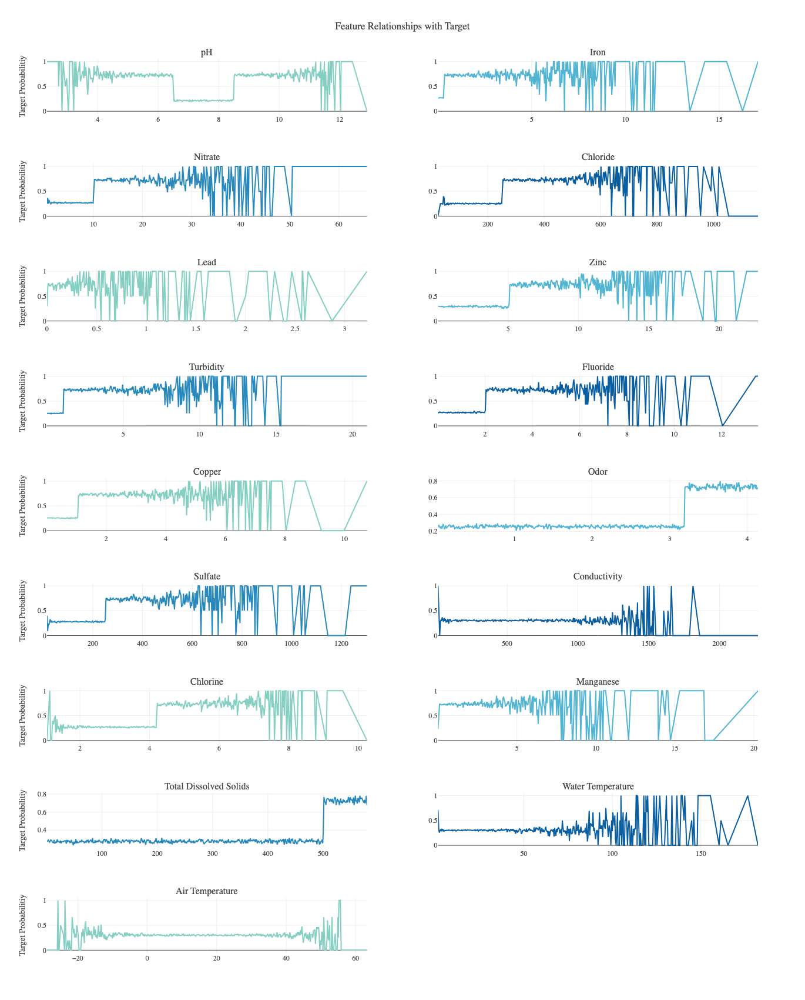

In [13]:
fig=make_subplots(rows=9,cols=2, subplot_titles=float_cols[1:])
col=[1,2]*9
row=0
pal=sns.color_palette("GnBu",20).as_hex()[9:][::3]

for i, column in enumerate(data[float_cols].columns[1:]):
    if i%2 == 0:
        row += 1
    df = pd.concat([data[column], data['Target']], axis=1)

    df['bins'] = pd.cut(df[column], 500)
    df['mean'] = df.bins.apply(lambda x: x.mid)

    df = df.groupby('mean')[[column,'Target']].transform('mean')
    df = df.drop_duplicates(subset=[column]).sort_values(by=column)
    
    fig.add_trace(go.Scatter(x=df[column], y=df.Target, name=column,
                             marker_color=pal[i % len(pal)], showlegend=False),
                  row=row, col=col[i])
    fig.update_xaxes(zeroline=False, row=row, col=col[i])
    if i%2 == 0:
        fig.update_yaxes(title='Target Probabilitiy',row=row,col=col[i]) 
fig.update_layout(template=temp, title='Feature Relationships with Target', hovermode="x unified",height=1700,width=1200)
fig.show()

In [14]:
def displayScatterplot(check_cols):
    check_cols_len = len(check_cols)

    plot_df=data[check_cols]
    fig, ax = plt.subplots(check_cols_len, check_cols_len, figsize=(16,18))
    fig.suptitle('Scatterplot Matrix of Numeric Variables\nLog-Transformed',fontsize=16)
    for i, col in enumerate(check_cols):
        for j, iter_col in enumerate(check_cols):
            ax[i,j].hexbin(x=iter_col, y=col, data=plot_df, bins='log', gridsize=40, cmap='coolwarm')
            ax[i,j].set(xlabel=iter_col, ylabel=(col if j % check_cols_len == 0 else ''))
            ax[i,j].text(plot_df[iter_col].median(), plot_df[col].max(), 
                         'Correlation: {:.4f}'.format(plot_df[[col,iter_col]].corr().iloc[1,0]), 
                       ha="center", va="center",bbox=dict(boxstyle="round,pad=0.3",fc="white"))
            ax[i,j].tick_params(left=False,bottom=False)    

    sns.despine()
    plt.tight_layout(rect=[0, 0, 1, 0.99])
    plt.show()

In [15]:
# display for chemicals
# displayScatterplot(['Nitrate', 'Chloride', 'Fluoride', 'Sulfate', 'Chlorine'])

In [16]:
# displayScatterplot(['Iron', 'Lead', 'Zinc', 'Copper', 'Manganese'])

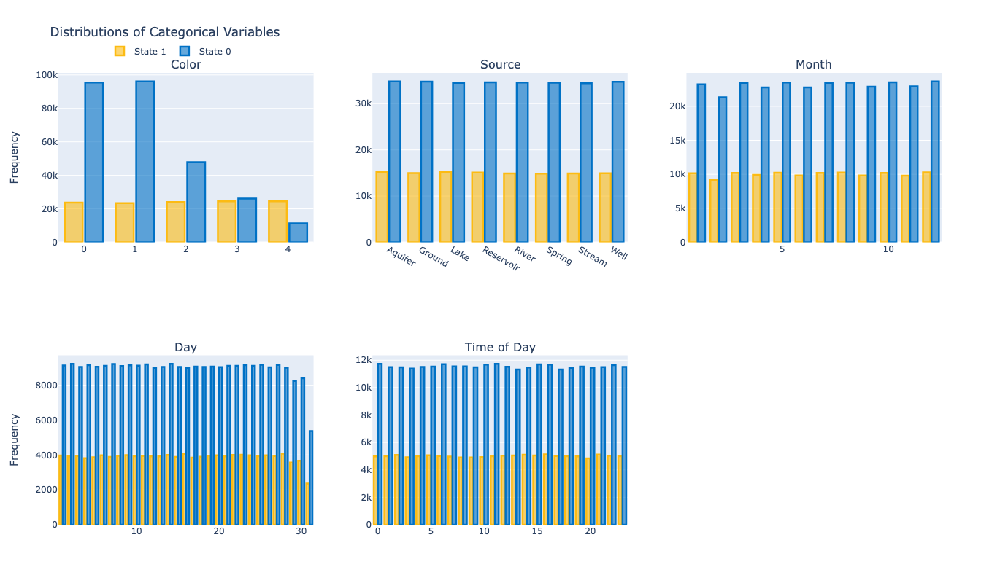

In [17]:
fig = make_subplots(rows=2, cols=3, subplot_titles=[c for c in cat_cols if c!='Target'])
rgb=['rgba'+str(matplotlib.colors.to_rgba(i,0.6)) for i in intel_pal]
row=0
c=[1,2,3]*2
for i, col in enumerate(c for c in cat_cols if c!='Target'):
    if i%3==0:
        row+=1

    df=data.groupby(col)['Target'].value_counts().rename('count').reset_index()
    x_1 = pd.Series(dtype=int)
    x_0 = pd.Series(dtype=int)
    mapping = {} # REMOVE ME
    if col in mapping:
        mapping_series = pd.Series(mapping[col])
        x_1 = mapping_series[df[df.Target==1][col]]
        x_0 = mapping_series[df[df.Target==0][col]]
    else:
        x_1 = df[df.Target==1][col]
        x_0 = df[df.Target==0][col]

    fig.add_trace(go.Bar(x=x_1,
                         y=df[df.Target==1]['count'],width=.35,
                         marker_color=rgb[1], marker_line=dict(color=intel_pal[1],width=2.5), 
                         hovertemplate='Value: %{x}<br>Count: %{y}',
                         name='State 1', showlegend=(True if i==0 else False)),
                  row=row, col=c[i])
    fig.add_trace(go.Bar(x=x_0,
                         y=df[df.Target==0]['count'],width=.35,
                         marker_color=rgb[0], marker_line=dict(color=intel_pal[0],width=2.5),
                         hovertemplate='Value: %{x}<br>Count: %{y}',
                         name='State 0', showlegend=(True if i==0 else False)),
                  row=row, col=c[i])
    if i%3==0:
        fig.update_yaxes(title='Frequency',row=row,col=c[i])
fig.update_layout(title="Distributions of Categorical Variables",
                  legend=dict(orientation="h",yanchor="bottom",y=1.025,xanchor="right",x=.2),
                  barmode='group',height=800,width=1200)
fig.show()

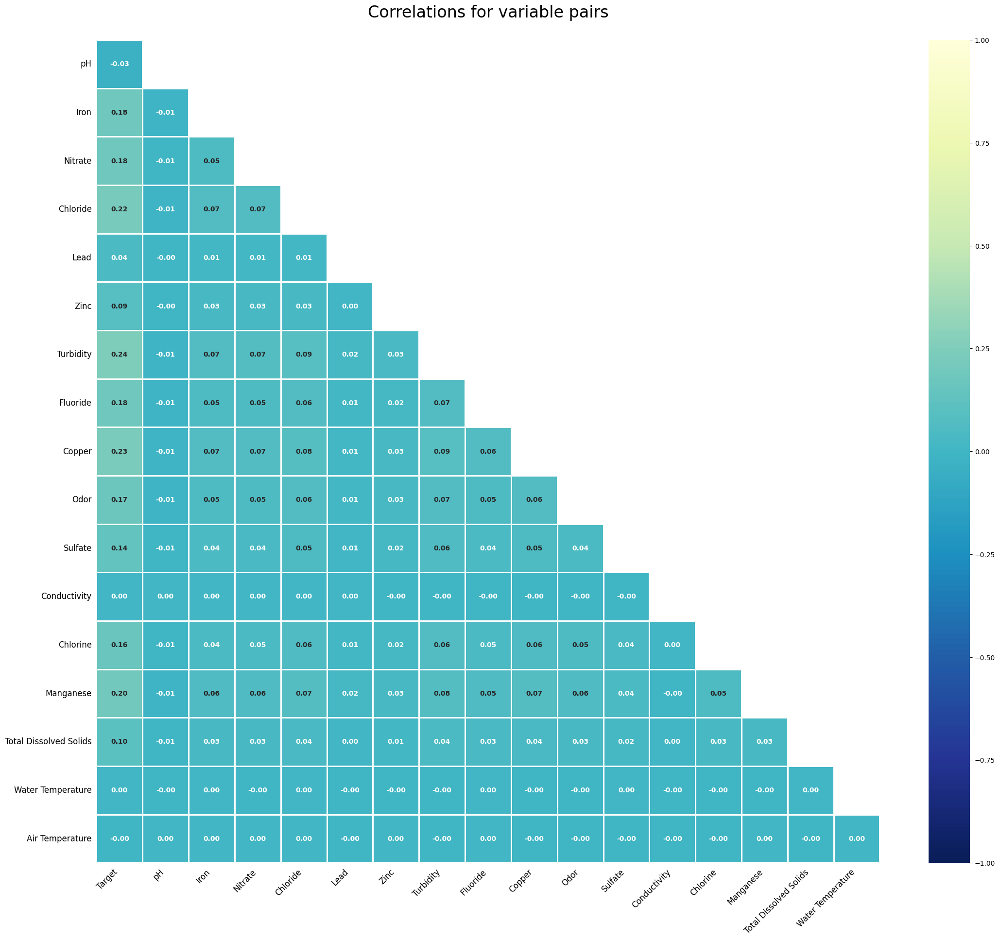

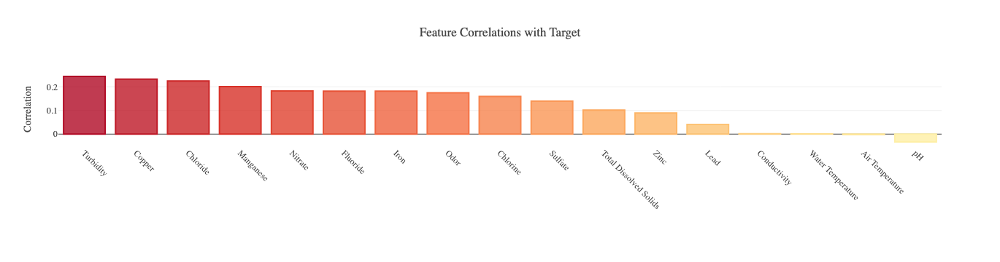

In [18]:
def plot_corr(corr):
    """
    Function to plot bottom left triangle of correlation matrix
    """
    mask=np.triu(np.ones_like(corr, dtype=bool))[1:,:-1]
    corr=corr.iloc[1:,:-1].copy()
    fig, ax = plt.subplots(figsize=(26,22))   
    sns.heatmap(corr, mask=mask, vmin=-1, vmax=1, center=0, annot=True, fmt='.2f', 
                cmap='YlGnBu_r',lw=2, annot_kws={'fontsize':10,'fontweight':'bold'}, cbar=True)
    ax.tick_params(left=False,bottom=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right',fontsize=12)
    ax.set_yticklabels(ax.get_yticklabels(),fontsize=12)
    plt.title('Correlations for variable pairs\n', fontsize=24)
    plt.show()
    
def plot_target_corr(corr, target_col): 
    """
    Function to plot a bar chart of correlations between target and features, sorted in descending order
    """
    corr=corr[target_col].sort_values(ascending=False)[1:]
    pal=sns.color_palette("RdYlBu",37).as_hex()
    pal=[j for i,j in enumerate(pal) if i not in (17,18)]
    rgb=['rgba'+str(matplotlib.colors.to_rgba(i,0.8)) for i in pal] 
    
    fig=go.Figure()
    fig.add_trace(go.Bar(x=corr.index, y=corr, marker_color=rgb,
                         marker_line=dict(color=pal,width=2),
                         hovertemplate='%{x} correlation with Target = %{y}',
                         showlegend=False, name=''))
    fig.update_layout(template=temp, title='Feature Correlations with Target', 
                      yaxis_title='Correlation', margin=dict(b=160), xaxis_tickangle=45)
    fig.show()


corr=data[float_cols].corr()
plot_corr(corr=corr)
plot_target_corr(corr=corr, target_col='Target')

In [19]:
# handle outliers
start = time.time()

handle_upper_cols = ['Iron', 'Lead', 'Zinc', 'Turbidity', 'Fluoride', 'Copper', 'Manganese', 'Nitrate',
                     'Chloride','Sulfate','Chlorine','Water Temperature','Air Temperature', 'Odor', 'Conductivity']
handle_lower_cols = ['Nitrate','Chloride', 'Sulfate','Chlorine', 'Air Temperature', 'Odor', 'Conductivity']

for col in data.columns:
    if data[col].dtype == 'object':
        continue
    lower, upper = np.percentile(data[col], [1, 99])
    if col in handle_upper_cols:
        data.loc[data[col] > upper, col] = upper
    if col in handle_lower_cols:
        data.loc[data[col] < lower, col] = lower

print("handle outliers took: {:.2f} s".format(time.time() - start))

handle outliers took: 0.16 s


In [20]:
# handle distribution

start = time.time()

standardize_cols = ['Iron', 'Nitrate', 'Chloride', 'Lead', 'Zinc', 'Turbidity', 'Fluoride', 'Copper','Sulfate', 'Manganese','Chlorine']
for col in standardize_cols:
    if col in data.columns:
        data[col] = np.log1p(data[col])

# for col in ['Iron','Lead','Manganese']:
#     if col in data.columns:
#         data[col], _ = yeojohnson(data[col])

# scaler = StandardScaler()
# for col in standardize_cols:
#     if col in data.columns:
#         data[col] = scaler.fit_transform(data[[col]])

print("handle distribution took: {:.2f} s".format(time.time() - start))

handle distribution took: 0.18 s


In [21]:
mapping = {}
labels_dict = {
#     'Odor': ['No Odor', 'Slight Odor', 'Noticeable Odor', 'Strong Odor'],
#     'Conductivity': ['Low', 'Medium', 'High'],
    'pH': ['Acidic', 'Neutral', 'Alkaline'],
    'Month': ['Q1', 'Q2', 'Q3', 'Q4'],
    'Day': ['Beginning', 'Middle', 'End'],
    'Time of Day': ['Night', 'Morning', 'Afternoon', 'Evening'],
}

# discretize features
data['Month'] = pd.cut(data['Month'], bins=[0, 3, 6, 9, 12], labels=labels_dict['Month'], include_lowest=True)
data['Day'] = pd.cut(data['Day'], bins=[0, 10, 20, 31], labels=labels_dict['Day'], include_lowest=True)
data['Time of Day'] = pd.cut(data['Time of Day'], bins=[0, 6, 12, 18, 24], labels=labels_dict['Time of Day'], include_lowest=True)
data['pH'] = pd.cut(data['pH'], bins=[0, 6.5, 8.5, 14], labels=labels_dict['pH'], include_lowest=True)
# data['Odor'] = pd.cut(data['Odor'], bins=[-np.inf, 1, 2, 3, np.inf], labels=labels_dict['Odor'])
# data['Conductivity'] = pd.cut(data['Conductivity'], bins=[-np.inf, 300, 600, np.inf], labels=labels_dict['Conductivity'])

# transform labels to numerics
for col in ['pH', 'Month', 'Day', 'Time of Day', 'Source']:
    data = pd.get_dummies(data, columns=[col], drop_first=False)

In [22]:
# drop duplicated rows
start = time.time()
data = data.drop_duplicates()
print("drop duplicates took: {:.2f} s".format(time.time() - start))

# check data
missing = data.isna().sum().sum()
duplicates = data.duplicated().sum()
print("\nThere are {:,.0f} missing values in the data.".format(missing))
print("There are {:,.0f} duplicate records in the data.".format(duplicates))

display(data.head())

drop duplicates took: 0.82 s

There are 0 missing values in the data.
There are 0 duplicate records in the data.


,Iron,Nitrate,Chloride,Lead,Zinc,Color,Turbidity,Fluoride,Copper,Odor,...,Time of Day_Afternoon,Time of Day_Evening,Source_Aquifer,Source_Ground,Source_Lake,Source_Reservoir,Source_River,Source_Spring,Source_Stream,Source_Well
1,3.594262e-03,2.504393,5.017380,3.992670e-61,1.524096,3,0.718551,0.884868,0.572956,0.503722,...,0,0,0,0,0,0,0,0,0,1
2,2.022952e-01,2.383086,4.849411,8.205945e-08,0.817903,1,0.001307,0.541242,0.036960,3.102165,...,1,0,0,0,0,0,1,0,0,0
4,9.183138e-07,2.364314,5.361905,7.907960e-56,0.588016,2,0.550037,0.164868,0.695983,0.561782,...,1,0,0,0,0,1,0,0,0,0
6,1.543835e-09,2.244422,5.569471,1.305907e-54,2.071788,4,0.353124,0.745666,1.224579,1.834220,...,0,1,1,0,0,0,0,0,0,0
7,2.814414e-02,1.901575,5.144552,1.524223e-51,1.459578,0,0.553332,0.847457,0.288961,0.079328,...,0,0,1,0,0,0,0,0,0,0


In [23]:
cat_cols,float_cols=[],['Target']
for col in data.columns:
    if data[col].value_counts().count() < 100:
        cat_cols.append(col)
    else:
        float_cols.append(col)
        
print(cat_cols)
print(float_cols)

['Color', 'Target', 'pH_Acidic', 'pH_Neutral', 'pH_Alkaline', 'Month_Q1', 'Month_Q2', 'Month_Q3', 'Month_Q4', 'Day_Beginning', 'Day_Middle', 'Day_End', 'Time of Day_Night', 'Time of Day_Morning', 'Time of Day_Afternoon', 'Time of Day_Evening', 'Source_Aquifer', 'Source_Ground', 'Source_Lake', 'Source_Reservoir', 'Source_River', 'Source_Spring', 'Source_Stream', 'Source_Well']
['Target', 'Iron', 'Nitrate', 'Chloride', 'Lead', 'Zinc', 'Turbidity', 'Fluoride', 'Copper', 'Odor', 'Sulfate', 'Conductivity', 'Chlorine', 'Manganese', 'Total Dissolved Solids', 'Water Temperature', 'Air Temperature']


In [24]:
# sns.set(style="whitegrid")

# for col in float_cols:
#     if col == 'Target':
#         continue
#     sns.boxplot(x="Target", y=col, data=data, whis=np.inf)
#     sns.stripplot(x="Target", y=col, data=data, jitter=True, color=".3")
#     plt.show()

# for col in cat_cols:
#     if col == 'Target':
#         continue
#     sns.barplot(x=col, y="Target", data=data)
#     plt.show()

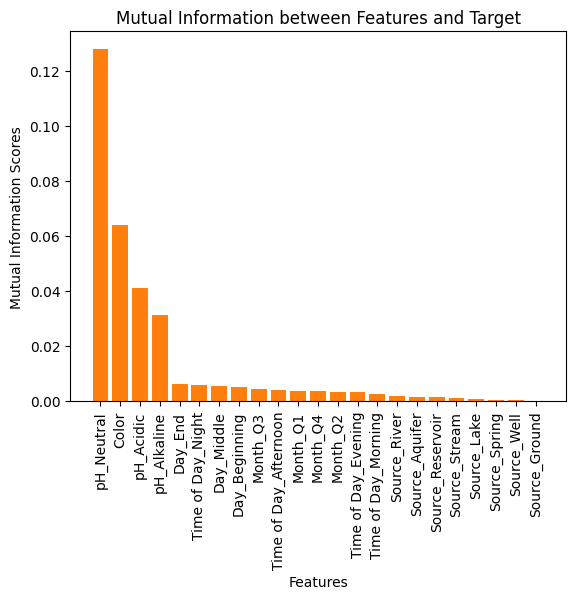

took: 80.94 s


In [25]:
from sklearn.feature_selection import mutual_info_classif

start = time.time()

columns = [x for x in cat_cols if x != 'Target']
X = data[columns]
y = data['Target']
mi_scores = mutual_info_classif(X, y)

# Create a DataFrame with features and scores
mi_df = pd.DataFrame({'Feature': X.columns, 'Score': mi_scores})

# Sort the DataFrame by Score
mi_df = mi_df.sort_values('Score', ascending=False)

# plt.figure(figsize=(20,8))  # (width, height)

plt.bar(mi_df['Feature'], mi_df['Score'], width=0.5)  # Set the width of the bars
plt.bar(X.columns, mi_scores)

plt.xlabel('Features')
plt.ylabel('Mutual Information Scores')
plt.title('Mutual Information between Features and Target')
plt.xticks(rotation=90)
plt.show()

print("took: {:.2f} s".format(time.time() - start))

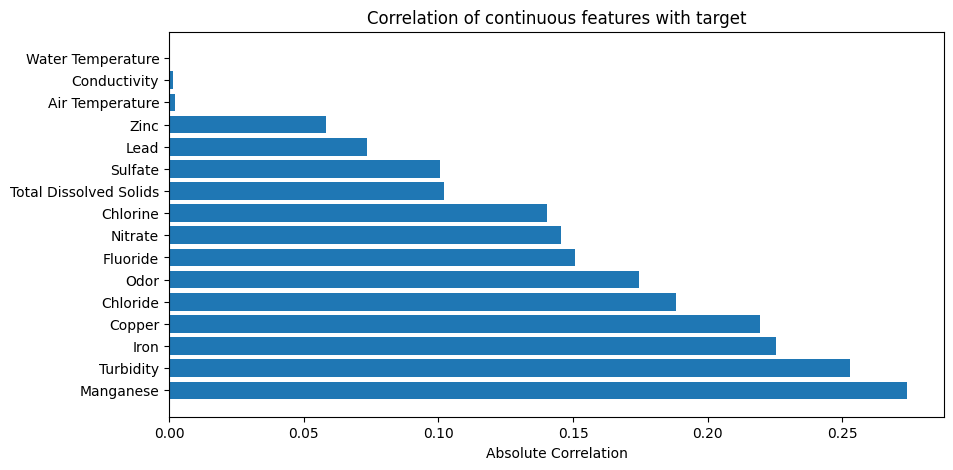

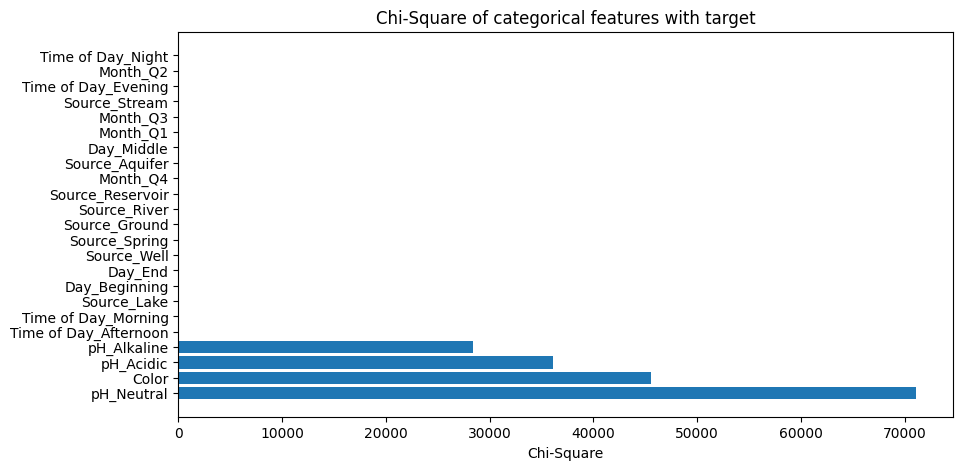

In [26]:
import scipy.stats as stats
import matplotlib.pyplot as plt

correlations = []
for col in float_cols:
    if col == 'Target':
        continue
    correlation, p_value = stats.pointbiserialr(data[col], data['Target'])
    correlations.append((col, abs(correlation)))

correlations.sort(key=lambda x: x[1], reverse=True) 
features, corr_values = zip(*correlations)
plt.figure(figsize=(10,5))
plt.barh(features, corr_values)
plt.xlabel('Absolute Correlation')
plt.title('Correlation of continuous features with target')
plt.show()

chi2_values = []
for col in cat_cols:
    if col == 'Target':
        continue
    chi2, p_value, dof, expected = stats.chi2_contingency(pd.crosstab(data['Target'], data[col]))
    chi2_values.append((col, chi2))

chi2_values.sort(key=lambda x: x[1], reverse=True)
features, chi2_vals = zip(*chi2_values)
plt.figure(figsize=(10,5))
plt.barh(features, chi2_vals)
plt.xlabel('Chi-Square')
plt.title('Chi-Square of categorical features with target')
plt.show()

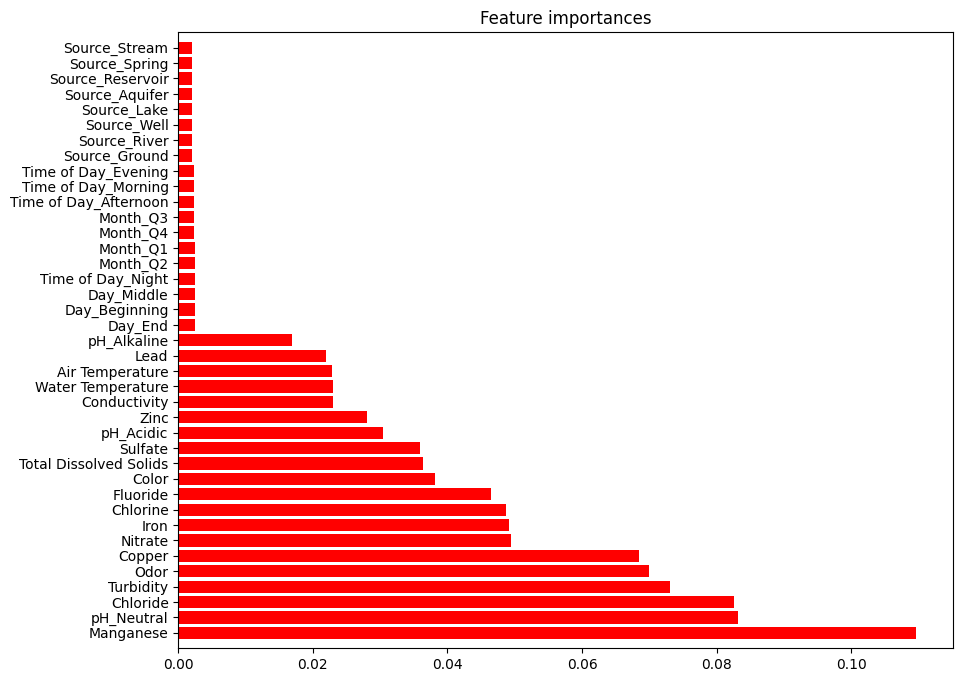

took: 13.94 s


In [27]:
from sklearn.ensemble import RandomForestClassifier

start = time.time()

features = [x for x in data.columns if x != 'Target']
target = 'Target'
X = data[features]
y = data[target]

rf = RandomForestClassifier(n_estimators=100)

rf.fit(X, y)

importances = rf.feature_importances_
indices = np.argsort(importances)[::-1]

features_ranked = [features[i] for i in indices]

plt.figure(figsize=(10, 8))
plt.title("Feature importances")
plt.barh(range(X.shape[1]), importances[indices], color="r", align="center")
plt.yticks(range(X.shape[1]), features_ranked)
plt.ylim([-1, X.shape[1]])
plt.show()

print("took: {:.2f} s".format(time.time() - start))

In [28]:
selected_features = [features[i] for i in indices if importances[i] > 0.01] # set 0.01 as threshold
print(selected_features)
data = data[selected_features + ['Target']]

['Manganese', 'pH_Neutral', 'Chloride', 'Turbidity', 'Odor', 'Copper', 'Nitrate', 'Iron', 'Chlorine', 'Fluoride', 'Color', 'Total Dissolved Solids', 'Sulfate', 'pH_Acidic', 'Zinc', 'Conductivity', 'Water Temperature', 'Air Temperature', 'Lead', 'pH_Alkaline']


In [29]:
import os
import time
import warnings
import random
import numpy as np

from xgboost import XGBClassifier, XGBRegressor
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import roc_auc_score, roc_curve, auc, accuracy_score, f1_score
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler
from sklearn.experimental import enable_iterative_imputer
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import cross_val_score, StratifiedKFold
from scipy.stats import yeojohnson
from sklearn.cluster import KMeans

import daal4py as d4p
import matplotlib.colors
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [30]:
def prepare_train_test_data(data, target_col, test_size):
    
    """
    Function to scale and split the data into training and test sets
    """
    
    scaler = RobustScaler()   
    X = data.drop(target_col, axis=1)
    y = data[target_col]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=21)
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    print("Train Shape: {}".format(X_train_scaled.shape))
    print("Test Shape: {}".format(X_test_scaled.shape))
    
    return X_train_scaled, X_test_scaled, y_train, y_test

def plot_model_res(model_name, y_test, y_prob):
    
    """
    Function to plot ROC/PR Curves and predicted target distribution
    """
    
    intel_pal=['#0071C5','#FCBB13']
    color=['#7AB5E1','#FCE7B2']
    
    ## ROC & PR Curve ##
    fpr, tpr, _ = roc_curve(y_test, y_prob)
    roc_auc = auc(fpr,tpr)
    precision, recall, _ = precision_recall_curve(y_test, y_prob)
    auprc = average_precision_score(y_test, y_prob)
    
    fig = make_subplots(rows=1, cols=2, 
                        shared_yaxes=True, 
                        subplot_titles=['Receiver Operating Characteristic<br>(ROC) Curve',
                                        'Precision-Recall Curve<br>AUPRC = {:.3f}'.format(auprc)])
    
    fig.add_trace(go.Scatter(x=np.linspace(0,1,11), y=np.linspace(0,1,11), 
                             name='Baseline',mode='lines',legendgroup=1,
                             line=dict(color="Black", width=1, dash="dot")), row=1,col=1)    
    fig.add_trace(go.Scatter(x=fpr, y=tpr, line=dict(color=intel_pal[0], width=3), 
                             hovertemplate = 'True positive rate = %{y:.3f}, False positive rate = %{x:.3f}',
                             name='AUC = {:.4f}'.format(roc_auc),legendgroup=1), row=1,col=1)
    fig.add_trace(go.Scatter(x=recall, y=precision, line=dict(color=intel_pal[0], width=3), 
                             hovertemplate = 'Precision = %{y:.3f}, Recall = %{x:.3f}',
                             name='AUPRC = {:.4f}'.format(auprc),showlegend=False), row=1,col=2)
    fig.update_layout(title="{} ROC and Precision-Recall Curves".format(model_name), 
                      hovermode="x unified", width=900,height=500,
                      xaxis1_title='False Positive Rate (1 - Specificity)',
                      yaxis1_title='True Positive Rate (Sensitivity)',
                      xaxis2_title='Recall (Sensitivity)',yaxis2_title='Precision (PPV)',
                      legend=dict(orientation='v', y=.07, x=.45, xanchor="right",
                                  bordercolor="black", borderwidth=.5))
    fig.show()
    
    ## Target Distribution ##     
    plot_df=pd.DataFrame.from_dict({'State 0':(len(y_prob[y_prob<=0.5])/len(y_prob))*100, 
                                    'State 1':(len(y_prob[y_prob>0.5])/len(y_prob))*100}, 
                                   orient='index', columns=['pct'])
    fig=go.Figure()
    fig.add_trace(go.Pie(labels=plot_df.index, values=plot_df.pct, hole=.45, 
                         text=plot_df.index, sort=False, showlegend=False,
                         marker=dict(colors=color,line=dict(color=intel_pal,width=2.5)),
                         hovertemplate = "%{label}: <b>%{value:.2f}%</b><extra></extra>"))
    fig.update_layout(title='Predicted Target Distribution',width=700,height=450,
                      uniformtext_minsize=15, uniformtext_mode='hide')
    fig.show()

In [31]:
## Prepare Train and Test datasets ##
print("Preparing Train and Test datasets")
X_train, X_test, y_train, y_test = prepare_train_test_data(data=data, 
                                                            target_col='Target', 
                                                            test_size=.25)

Preparing Train and Test datasets
Train Shape: (297799, 20)
Test Shape: (99267, 20)



Tuning hyperparameters..
Fitting 3 folds for each of 25 candidates, totalling 75 fits


/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:35

Tune hyperparameter took:  67.04257559776306
Done!
Best hyperparameters: {'C': 10.0, 'penalty': 'l2', 'solver': 'newton-cg'}
Best cross-validation AUC: 0.8790

Test F1 accuracy: 73.82%, AUC: 0.88033


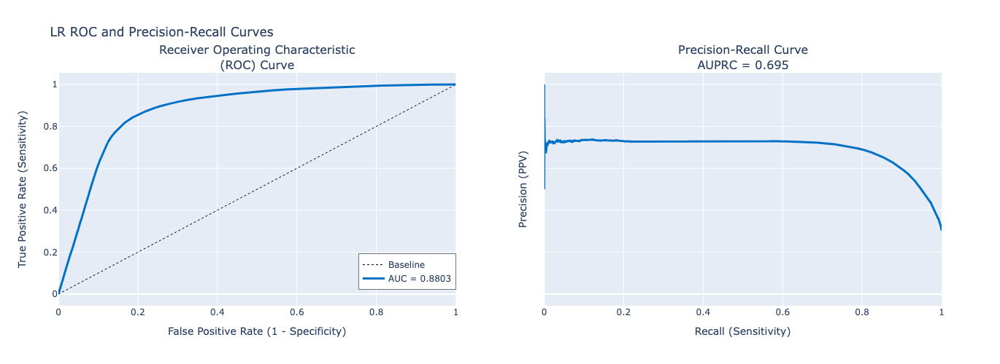

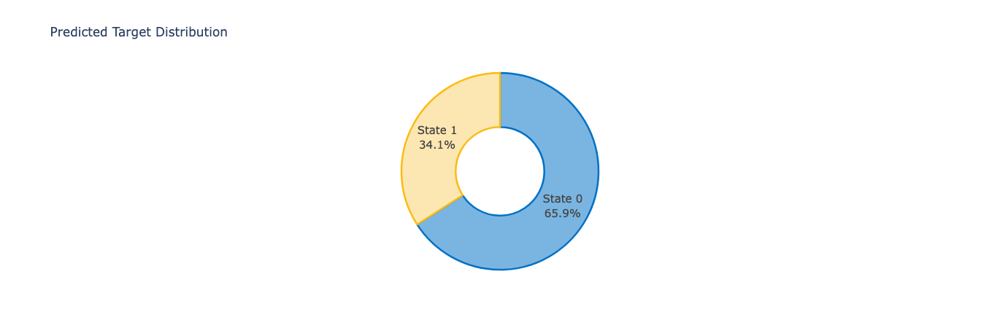

In [32]:
## Initialize LR model ##
parameters = {
    'class_weight': 'balanced',
    'random_state': 21
}
lr = LogisticRegression(**parameters)

## Tune Hyperparameters ##
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")
grid = {
    'C': np.logspace(-1, 1, 5),
    'penalty': ['l2'],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
}
grid_search = GridSearchCV(lr, param_grid=grid, 
                            cv=strat_kfold, scoring='roc_auc', 
                            verbose=1, n_jobs=-1)
grid_search.fit(X_train, y_train)
    
print("Tune hyperparameter took: ", time.time() - start_tune)
print("Done!\nBest hyperparameters:", grid_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(grid_search.best_score_))

lr = grid_search.best_estimator_
lr_prob = lr.predict_proba(X_test)[:,1]
lr_pred = pd.Series(lr.predict(X_test), name='Target')
lr_auc = roc_auc_score(y_test, lr_prob)
lr_f1 = f1_score(y_test, lr_pred)  
   
## Print model results ##
print("\nTest F1 accuracy: {:.2f}%, AUC: {:.5f}".format(lr_f1*100,lr_auc))
plot_model_res(model_name='LR', y_test=y_test, y_prob=lr_prob)

In [ ]:
## Initialize XGBoost model ##
ratio = float(np.sum(y_train == 0)) / np.sum(y_train == 1)
parameters = {'scale_pos_weight': ratio.round(2), 
                'tree_method': 'hist',
                'random_state': 21}
xgb_model = XGBClassifier(**parameters)

## Tune hyperparameters ##
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")
grid = {
    'min_child_weight': [1, 5, 10],
    'gamma': [0.5, 1, 1.5, 2, 5],
    'max_depth': [3, 4, 5],
}

grid_search = GridSearchCV(xgb_model, param_grid=grid, 
                            cv=strat_kfold, scoring='roc_auc', 
                            verbose=1, n_jobs=-1)
grid_search.fit(X_train, y_train)

print("Tune hyperparameter took: ", time.time() - start_tune)
print("Done!\nBest hyperparameters:", grid_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(grid_search.best_score_))

## Convert XGB model to daal4py ##
xgb = grid_search.best_estimator_
daal_model = d4p.get_gbt_model_from_xgboost(xgb.get_booster())

## Calculate predictions ##
daal_prob = d4p.gbt_classification_prediction(nClasses=2,
    resultsToEvaluate="computeClassLabels|computeClassProbabilities",
    fptype='float').compute(X_test, daal_model).probabilities # or .predictions
xgb_pred = pd.Series(np.where(daal_prob[:,1]>.5, 1, 0), name='Target')
xgb_auc = roc_auc_score(y_test, daal_prob[:,1])
xgb_f1 = f1_score(y_test, xgb_pred)  
    
## Plot model results ##
print("\nTest F1 Accuracy: {:.2f}%, AUC: {:.5f}".format(xgb_f1*100, xgb_auc)) 
plot_model_res(model_name='XGBoost', y_test=y_test, y_prob=daal_prob[:,1])


Tuning hyperparameters..
Fitting 3 folds for each of 45 candidates, totalling 135 fits
Tune hyperparameter took:  51.71992492675781
Done!
Best hyperparameters: {'gamma': 1.5, 'max_depth': 5, 'min_child_weight': 5}
Best cross-validation AUC: 0.9180

Test F1 Accuracy: 82.50%, AUC: 0.91928


Tune hyperparameter took:  139.74361300468445
Done!
Best hyperparameters: {'n_estimators': 200, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 20, 'bootstrap': False}
Best cross-validation AUC: 0.9180

Test F1 accuracy: 83.50%, AUC: 0.91937


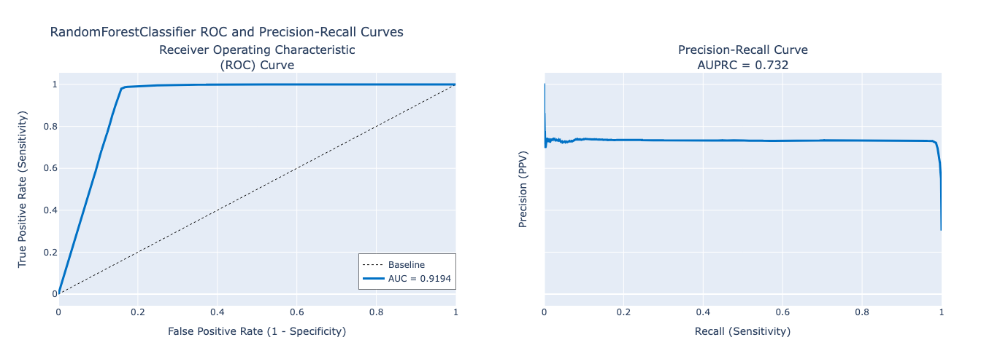

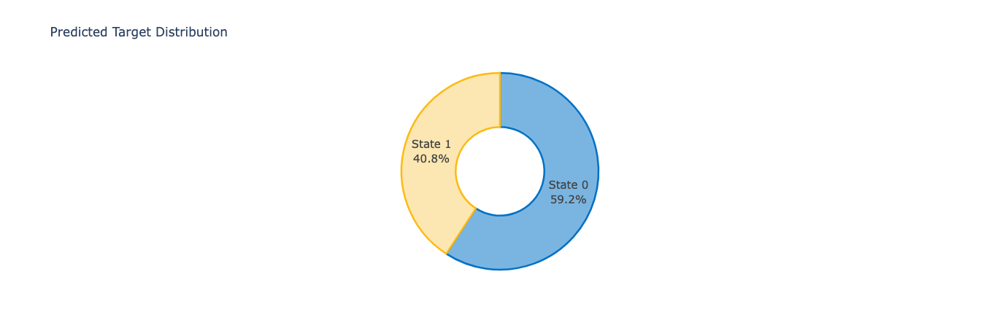

In [34]:
## Initialize RandomForestClassifier model ##
parameters = {
    'class_weight': 'balanced',
    'random_state': 21}
rfc = RandomForestClassifier(**parameters)

## Tune Hyperparameters ##
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")
grid = {
    'n_estimators': [10, 50, 100, 200, 500],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}
rand_search = RandomizedSearchCV(rfc, param_distributions=grid, 
                                    cv=strat_kfold, n_iter=5, scoring='roc_auc', 
                                    verbose=1, n_jobs=-1, random_state=21)
rand_search.fit(X_train, y_train)
    
print("Tune hyperparameter took: ", time.time() - start_tune)
print("Done!\nBest hyperparameters:", rand_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(rand_search.best_score_))

rfc = rand_search.best_estimator_
rfc_prob = rfc.predict_proba(X_test)[:,1]
rfc_pred = pd.Series(rfc.predict(X_test), name='Target')
rfc_auc = roc_auc_score(y_test, rfc_prob)
rfc_f1 = f1_score(y_test, rfc_pred)  

## Print model results ##
print("\nTest F1 accuracy: {:.2f}%, AUC: {:.5f}".format(rfc_f1*100,rfc_auc))
plot_model_res(model_name='RandomForestClassifier', y_test=y_test, y_prob=rfc_prob)


Tuning hyperparameters..
Fitting 3 folds for each of 5 candidates, totalling 15 fits


/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages

Done!
Best hyperparameters: {'solver': 'adam', 'learning_rate': 'constant', 'hidden_layer_sizes': (50, 100, 50), 'alpha': 0.05, 'activation': 'relu'}
Best cross-validation AUC: 0.9161
Tune hyperparameter took:  1028.59419298172

Test F1 accuracy: 83.09%, AUC: 0.91862


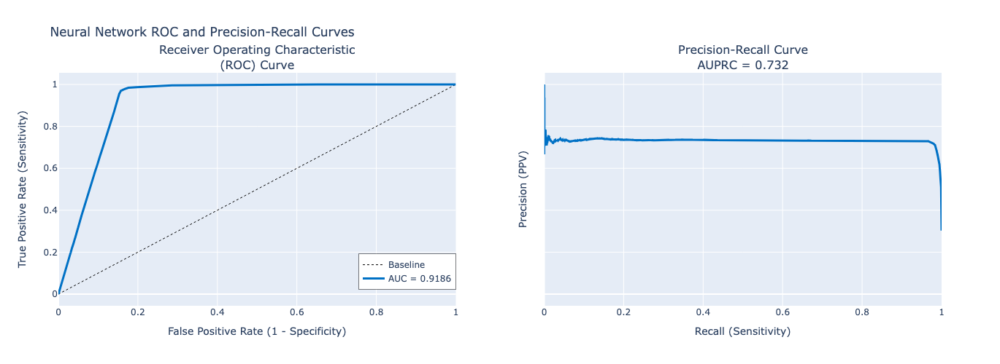

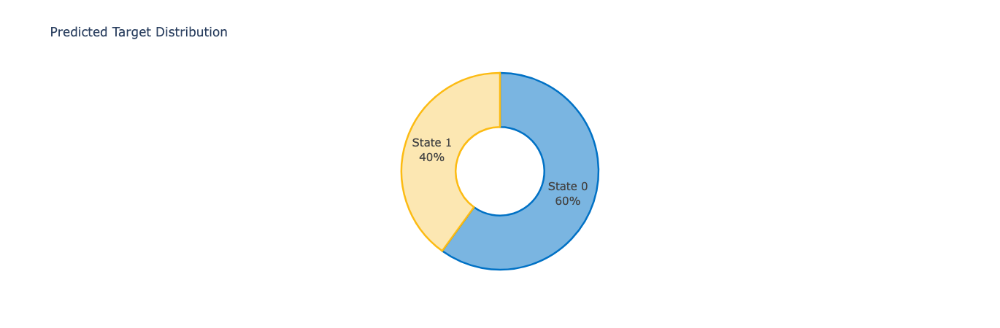

In [35]:
## Initialize MLP (Neural Network) model ##
parameters = {
    'max_iter': 200,
    'random_state': 21
}
mlp = MLPClassifier(**parameters)

## Tune Hyperparameters ##
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")

grid = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive']
}
rand_search = RandomizedSearchCV(mlp, param_distributions=grid, 
                                    cv=strat_kfold, n_iter=5, scoring='roc_auc', 
                                    verbose=1, n_jobs=-1, random_state=21)
rand_search.fit(X_train, y_train)
    
print("Done!\nBest hyperparameters:", rand_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(rand_search.best_score_))
print("Tune hyperparameter took: ", time.time() - start_tune)

mlp = rand_search.best_estimator_
mlp_prob = mlp.predict_proba(X_test)[:,1]
mlp_pred = pd.Series(mlp.predict(X_test), name='Target')
mlp_auc = roc_auc_score(y_test, mlp_prob)
mlp_f1 = f1_score(y_test, mlp_pred)  
   
## Print model results ##
print("\nTest F1 accuracy: {:.2f}%, AUC: {:.5f}".format(mlp_f1*100,mlp_auc))
plot_model_res(model_name='Neural Network', y_test=y_test, y_prob=mlp_prob)

/home/u188545/.local/lib/python3.9/site-packages/shap/utils/_clustering.py:35: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.

/home/u188545/.local/lib/python3.9/site-packages/shap/utils/_clustering.py:54: NumbaDeprecationWarning:

The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.

/home/u188545/.local/lib/python3.9/site-packages/shap/utils/_clustering.py:63: NumbaDeprecationWarning:

The 'nopy

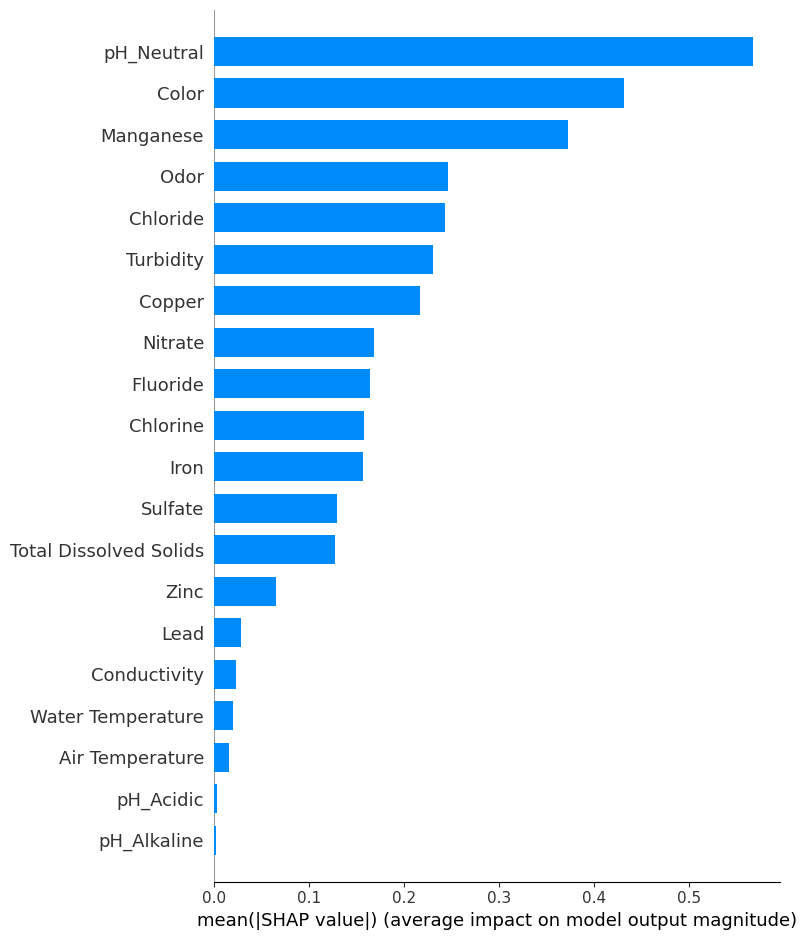

Explain XGB took:  20.415096759796143


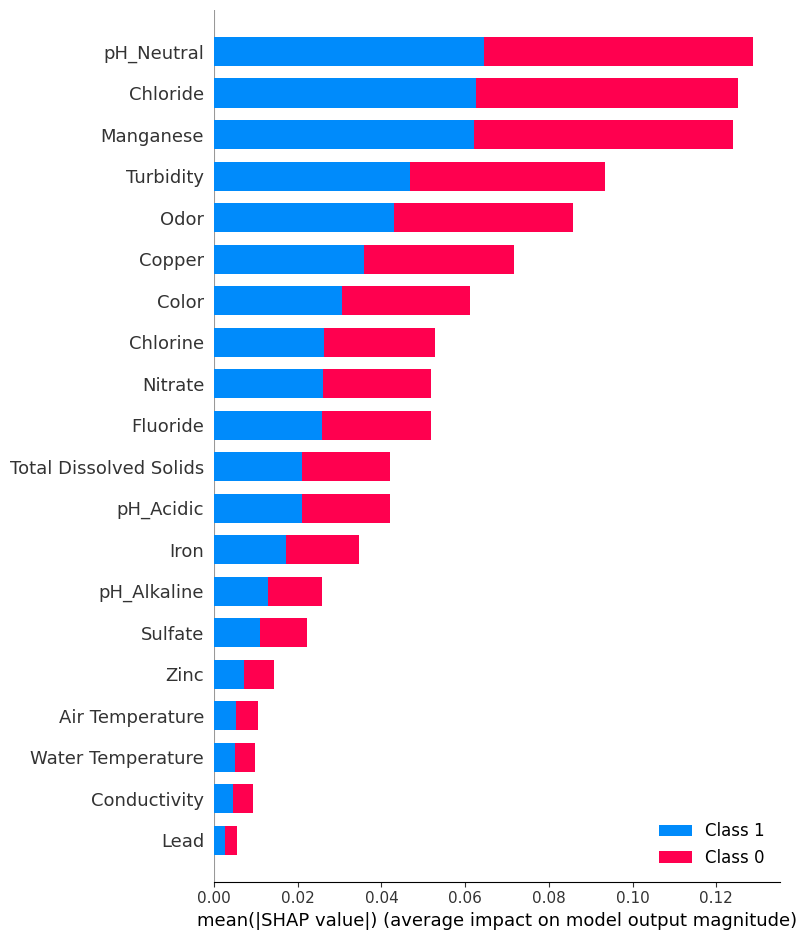

Explain RF took:  214.90386080741882


In [36]:
import shap

columns = [x for x in data.columns if x != 'Target']
df = pd.DataFrame(X_train, columns=columns)
sampled_df = df.sample(n=100)

# start = time.time()
# lr_explainer = shap.KernelExplainer(lr.predict_proba, sampled_df)
# lr_shap_values = lr_explainer.shap_values(sampled_df)
# shap.initjs()
# shap.summary_plot(lr_shap_values, sampled_df, plot_type="bar")
# print("Explain LR took: ", time.time() - start)

start = time.time()
xgb_explainer = shap.TreeExplainer(xgb)
xgb_shap_values = xgb_explainer.shap_values(df)
shap.initjs()
shap.summary_plot(xgb_shap_values, df, plot_type="bar")
print("Explain XGB took: ", time.time() - start)

start = time.time()
rf_explainer = shap.TreeExplainer(rfc)
rf_shap_values = rf_explainer.shap_values(sampled_df)
shap.initjs()
shap.summary_plot(rf_shap_values, sampled_df, plot_type="bar")
print("Explain RF took: ", time.time() - start)

# start = time.time()
# mlp_explainer = shap.KernelExplainer(mlp.predict_proba, sampled_df)
# mlp_shap_values = mlp_explainer.shap_values(sampled_df)
# shap.initjs()
# shap.summary_plot(mlp_shap_values, sampled_df, plot_type="bar")
# print("Explain MLP took: ", time.time() - start)